In [51]:
import numpy as np
import scipy as sp
from scipy import interpolate
import matplotlib.pyplot as plt

import plotly as ply
import plotly.graph_objects as go
import plotly.express as px

In [57]:
c = 3*10**8

def FSPL(range_in_km):
    linear = ((433*10**6)*4*np.pi*range_in_km*1000/c)**-2
    db = 10*np.log10(linear)
    return db

def gain_rough(angle):
    angles = [0,10,20,30,40,50,60,70,80,90]
    gain =   [0.9,0.8,0.28,-0.2,-1.16,-1.76,-2.6,-3.44,-3.8,-4]#80
    gain_continuous = interpolate.interp1d(angles,gain)
    return gain_continuous(angle)

def link_margin(principle,slant_range,angle,flatten=True):
    marg = principle+gain_rough(angle)+FSPL(slant_range)
    if(flatten):
        if(marg<0):
            return 0
    return marg

def margin_matrix(principle,range_start,range_end,N=500):
    margin = np.zeros([N,N])
    slant_ranges = np.linspace(range_start, range_end, N)
    angles = np.linspace(0, 90, N)

    i, j = 0, 0;
    for i in range(0,N-1):
        for j in range(0,N-1):
            margin[i,j] = link_margin(principle,slant_ranges[i],angles[j],flatten=True)

    return margin, slant_ranges, angles#Fix for plotly plotting

def plot_margin(principle,range_start,range_end,title,N=500):
    [m,slant_ranges,angles] = margin_matrix(principle,range_start,range_end,N=500)
    fig = go.Figure(data=[go.Surface(z=np.transpose(m),x=slant_ranges,y=angles,colorscale = px.colors.sequential.thermal)])

    fig.update_layout(title=title, autosize=True,
                        width=800, height=800,
                        scene = dict(
                        xaxis_title='Slant Range (kilometers)',
                        yaxis_title='Pointing Error (degrees)',
                        zaxis_title='Link Margin'))

    fig.show(renderer='notebook',width=800, height=800)
    return m,slant_ranges,angles

def contour(margin,slant_ranges,angles):
    fig = go.Figure(data =
        go.Contour(
            z=np.transpose(margin),x=slant_ranges,y=angles,colorscale = px.colors.sequential.thermal
        ))
    fig.show()

In [55]:
precision = 2
p = 147

print('Perfect Pointing (1330 km slant range): '+str(round(link_margin(p,1330,0),precision))+ ' dB')
print('10 degree error (1330 km slant range): '+str(round(link_margin(p,1330,10),precision))+ ' dB')
print('30 degree error (1330 km slant range): '+str(round(link_margin(p,1330,30),precision))+ ' dB\n')

print('Perfect Pointing (1370 km slant range): '+str(round(link_margin(p,1370,0),precision))+ ' dB')

print(FSPL(400))
print(FSPL(1100))
print(gain_rough(0))
print(gain_rough(90))

Perfect Pointing (1330 km slant range): 0.25 dB
10 degree error (1330 km slant range): 0.15 dB
30 degree error (1330 km slant range): 0 dB

Perfect Pointing (1370 km slant range): 0 dB
-137.21272993967523
-145.99938381628047
0.9
-4.0


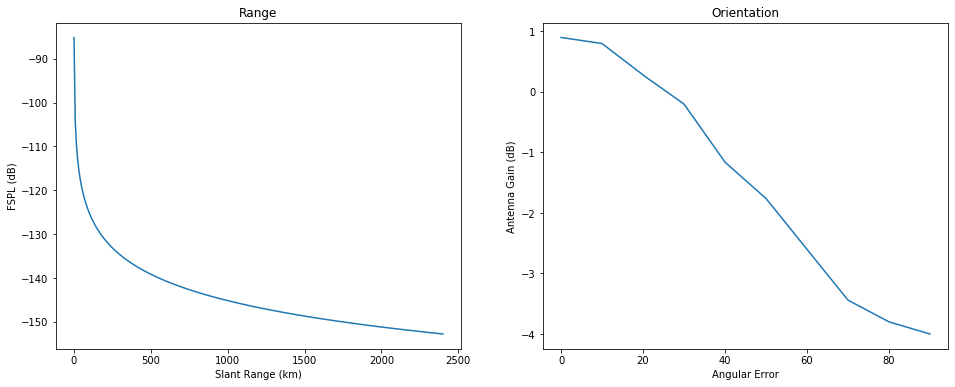

In [74]:
plt.rcParams['figure.figsize'] = [16, 6]
fig, (ax1, ax2) = plt.subplots(1, 2)


x = np.linspace(1,2400,300)
y = FSPL(x)
ax1.plot(x,y);
ax1.set_title('Range');
ax1.set_xlabel('Slant Range (km)');
ax1.set_ylabel('FSPL (dB)');

x = np.linspace(0,90,300)
y = gain_rough(x)
ax2.plot(x,y);
ax2.set_title('Orientation');
ax2.set_xlabel('Angular Error');
ax2.set_ylabel('Antenna Gain (dB)');

In [59]:
[m,slant_ranges,angles] = plot_margin(147,400,2400,'Current Design (0.5 W)');

In [60]:
contour(m,slant_ranges,angles)

In [42]:
plot_margin(150,400,2400,'Extra Power (1 W)');

In [76]:
plot_margin(153,400,2400,'Extra Power (2 W)');